# Identifying Trajectories with MAGIK

<div style="background-color: #f0f8ff; border: 2px solid #4682b4; padding: 10px;">
<a href="https://colab.research.google.com/github/DeepTrackAI/DeepLearningCrashCourse/blob/main/Ch011_GNN/ec11_B_magik/magik.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
<strong>If using Colab/Kaggle:</strong> You need to uncomment the code in the cell below this one.
</div>

In [1]:
!pip install deeplay  # Uncomment if using Colab/Kaggle.

This notebook provides you with a complete code example to track the motion of cells using a simplified version of MAGIK.

<div style="background-color: #f0f8ff; border: 2px solid #4682b4; padding: 10px;">
<strong>Note:</strong> This notebook contains the Code Example 11-B from the book  

**Deep Learning Crash Course**  
Giovanni Volpe, Benjamin Midtvedt, Jesús Pineda, Henrik Klein Moberg, Harshith Bachimanchi, Joana B. Pereira, Carlo Manzo  
No Starch Press, San Francisco (CA), 2026  
ISBN-13: 9781718503922  

[https://nostarch.com/deep-learning-crash-course](https://nostarch.com/deep-learning-crash-course)

You can find the other notebooks on the [Deep Learning Crash Course GitHub page](https://github.com/DeepTrackAI/DeepLearningCrashCourse).
</div>

## Exploring the Cell Tracking Data

Download the dataset ...

In [2]:
import os
from torchvision.datasets.utils import _extract_zip, download_url

dataset_name = "DIC-C2DH-HeLa"
dataset_path = os.path.join(".", "cell_detection_dataset")
if not os.path.exists(dataset_path):
    url = ("http://data.celltrackingchallenge.net/training-datasets/"
           f"{dataset_name}.zip")
    download_url(url, ".")
    _extract_zip(f"{dataset_name}.zip", dataset_path, None)
    os.remove(f"{dataset_name}.zip")

... load the images ...

In [3]:
import cv2, glob

def load_images(path):
    """Load images."""
    images = []
    for file in sorted(glob.glob(path + "/*.tif")):
        image = cv2.imread(file, cv2.IMREAD_UNCHANGED)
        images.append(image)
    return images

train_image_path = os.path.join(dataset_path, "DIC-C2DH-HeLa", "02")
train_images = load_images(train_image_path)

train_seg_path = os.path.join(dataset_path, "DIC-C2DH-HeLa", "02_ST", "SEG")
train_segs = load_images(train_seg_path)

... and visualize some of the images and corresponding segmentations.

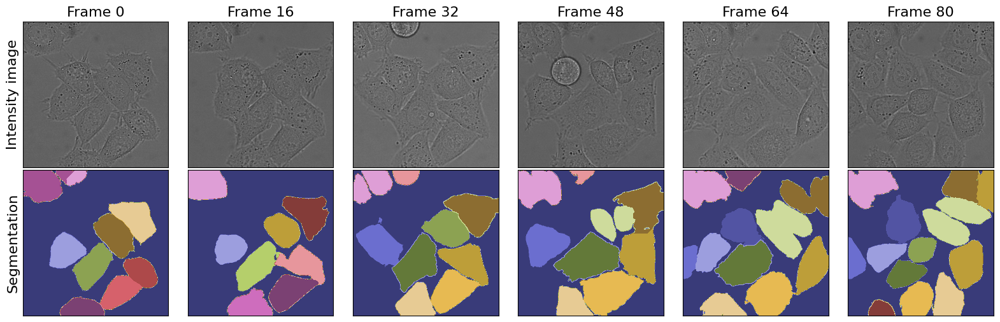

In [4]:
import matplotlib.pyplot as plt

frames_to_plot = [i for i in range(0, len(train_segs), len(train_segs) // 5)]

fig, axs = plt.subplots(2, len(frames_to_plot), figsize=(20, 6))
fig.patch.set_facecolor("white")
for i, frame in enumerate(frames_to_plot):
    axs[0, i].imshow(train_images[frame], cmap="gray")
    axs[0, i].set_title(f"Frame {frame}", fontsize=16)
    axs[0, i].tick_params(axis="both", which="both", bottom=False, top=False,
                          left=False, right=False, labelleft=False,
                          labelbottom=False)
    if i == 0: axs[0, i].set_ylabel("Intensity image", fontsize=16)

    axs[1, i].imshow(train_segs[frame], cmap="tab20b")
    axs[1, i].tick_params(axis="both", which="both", bottom=False, top=False,
                          left=False, right=False, labelleft=False,
                          labelbottom=False)
    if i == 0: axs[1, i].set_ylabel("Segmentation", fontsize=16)
plt.subplots_adjust(wspace=0.02, hspace=0.02)
plt.show()

## Creating a Graph From Segmented Images

Implement a class to obtain a graph from the segmentations ...

In [5]:
import numpy as np
import torch
from skimage import measure
from torch_geometric.data import Data

class GraphFromSegmentations:
    """Graph representation of the motion of cells."""

    def __init__(self, connectivity_radius, max_frame_distance):
        """Initialize graph."""
        self.connectivity_radius = connectivity_radius
        self.max_frame_distance = max_frame_distance

    def get_node_attr(self, segmentation):
        """Compute node attributes."""
        labels = np.unique(segmentation)[1:]  # Labels without background
        node_attr = []
        for label in labels:
            mask = segmentation == label
            props = measure.regionprops(mask.astype(np.int32))[0]
            centroid = props.centroid / np.array(segmentation.shape)
            eccentricity = props.eccentricity
            node_attr.append([*centroid, eccentricity])
        return node_attr, labels

    def get_connectivity(self, node_attr, frames):
        """Compute connectivity."""
        xy = node_attr[:, :2]  # Extracted centroids
        distances = np.linalg.norm(xy[:, None] - xy, axis=-1)
        frame_diff = (frames[:, None] - frames) * -1
        mask = ((distances < self.connectivity_radius)
                & (frame_diff <= self.max_frame_distance) & (frame_diff > 0))
        edge_index, edge_attr = np.argwhere(mask), distances[mask]
        return edge_index, edge_attr

    def get_gt_connectivity(self, labels, edge_index, relation):
        """Compute ground truth connectivity."""
        src_cell = labels[edge_index[:, 0]]
        tgt_cell = labels[edge_index[:, 1]]
        self_connections_mask = src_cell == tgt_cell
    
        relation_labels = relation[:, [-1, 0]]
        relation_labels = relation_labels[relation_labels[:, 0] != 0]
        relation_mask = np.zeros(len(edge_index), dtype=bool)
        for i, (s, t) in enumerate(zip(src_cell, tgt_cell)):
            if np.any((relation_labels == [s, t]).all(1)):
                relation_mask[i] = True
    
        gt_connectivity = self_connections_mask | relation_mask
        return gt_connectivity

    def __call__(self, segmentations, relation):
        """Compute graph."""
        node_attr, node_labels, frames = [], [], []
        for frame, segmentation in enumerate(segmentations):
            features, labels = self.get_node_attr(segmentation)
            node_attr.append(features), node_labels.append(labels)
            frames.append([frame] * len(features))
        node_attr = np.concatenate(node_attr)
        node_labels = np.concatenate(node_labels)
        frames = np.concatenate(frames)
    
        edge_index, edge_attr = self.get_connectivity(node_attr, frames)
        edge_gt = self.get_gt_connectivity(node_labels, edge_index, relation)
    
        graph = Data(
            x=torch.tensor(node_attr, dtype=torch.float),
            edge_index=torch.tensor(edge_index.T, dtype=torch.long),
            edge_attr=torch.tensor(edge_attr[:, None], dtype=torch.float),
            distance=torch.tensor(edge_attr[:, None], dtype=torch.float),
            frames=torch.tensor(frames, dtype=torch.float),
            y=torch.tensor(edge_gt[:, None], dtype=torch.float),
        )
        return graph

... instantiate it ...

In [6]:
graph_constructor = GraphFromSegmentations(connectivity_radius=0.2,
                                           max_frame_distance=2)

... use it to construct the training graph ...

In [7]:
train_file = os.path.join(dataset_path, "DIC-C2DH-HeLa", "02_GT", "TRA",
                          "man_track.txt")
train_graph = graph_constructor(segmentations=train_segs,
                                relation=np.loadtxt(train_file, dtype=int))

... verify the number of nodes and edges ...

In [8]:
print("Number of nodes:", len(train_graph.x))
print("Number of edges:", len(train_graph.edge_index[0]))

Number of nodes: 988
Number of edges: 3036


... and plot the graph.

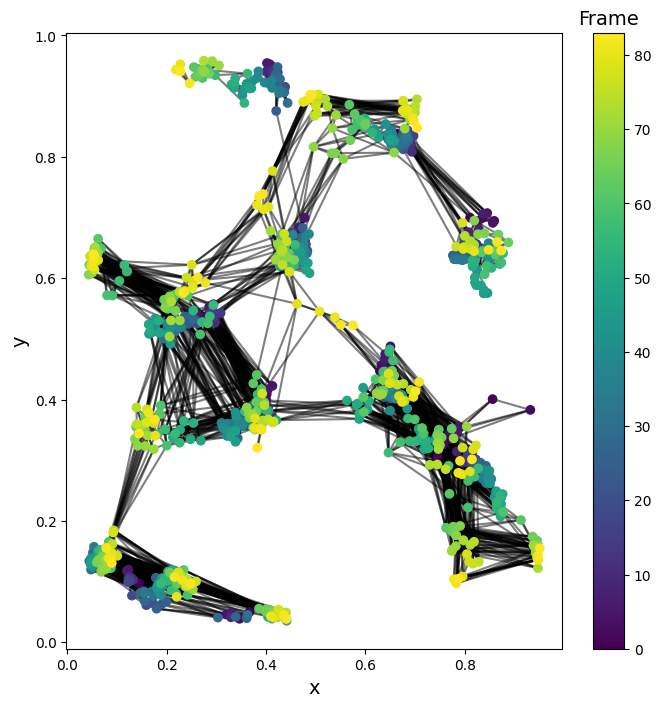

In [9]:
plt.figure(figsize=(8, 8))
for i, j in train_graph.edge_index.T:
    plt.plot([train_graph.x[i, 1], train_graph.x[j, 1]],
             [train_graph.x[i, 0], train_graph.x[j, 0]], c="black", alpha=0.5)
plt.scatter(train_graph.x[:, 1], train_graph.x[:, 0],
            c=train_graph.frames, cmap="viridis", zorder=10)
cb = plt.colorbar()
cb.ax.set_title("Frame", fontsize=14)
plt.xlabel("x", fontsize=14)
plt.ylabel("y", fontsize=14)
plt.show()

## Building a Training Dataset

Implement a class to prepare the graph dataset ...

In [10]:
class CellTracingDataset(torch.utils.data.Dataset):
    """Class to prepare the graph dataset."""

    def __init__(self, graph, Dt, dataset_size, transform=None):
        """Initialize the graph dataset."""
        self.graph, self.Dt, self.dataset_size, self.transform = \
            graph, Dt, dataset_size, transform

    def __len__(self):
        """Obtain length of dataset."""
        return self.dataset_size

    def __getitem__(self, idx):
        """Return a graph from the dataset."""
        frames, edge_index = self.graph.frames, self.graph.edge_index
        select_frame = np.random.randint(self.Dt, frames.max() + 1)

        start_frame = select_frame - self.Dt
        node_mask = (frames >= start_frame) & (frames < select_frame)
        node_attr = self.graph.x[node_mask]

        frame_pairs = torch.stack([frames[edge_index[0, :]],
                                   frames[edge_index[1, :]]], axis=1)
        edge_mask = (frame_pairs >= start_frame) & (frame_pairs < select_frame)
        edge_mask = edge_mask.all(axis=1)
        edge_index = edge_index[:, edge_mask] - edge_index[:, edge_mask].min()

        graph = Data(
            x=node_attr,
            edge_index=edge_index,
            edge_attr=self.graph.edge_attr[edge_mask],
            distance=self.graph.edge_attr[edge_mask],
            y=self.graph.y[edge_mask],  # Ground truth edges.
        )
        if self.transform: graph = self.transform(graph)
        return graph

... implement some classes to define random rotation and random flip ...

In [11]:
from math import cos, pi, sin

class RandomRotation:
    """Random rotation."""

    def __call__(self, graph):
        """Perform the random rotation."""
        graph = graph.clone()
        node_attr = graph.x[:, :2] - 0.5  # Centered positions
        angle = np.random.rand() * 2 * pi
        R = torch.tensor([[cos(angle), -sin(angle)], [sin(angle), cos(angle)]])
        rotated_node_attr = torch.matmul(node_attr, R)
        graph.x[:, :2] = rotated_node_attr + 0.5  # Restored positions
        return graph

class RandomFlip:
    """Random flip."""

    def __call__(self, graph):
        """Perform the random flip."""
        graph = graph.clone()
        node_attr = graph.x[:, :2] - 0.5  # Centered positions
        if np.random.randint(2): node_attr[:, 0] *= -1
        if np.random.randint(2): node_attr[:, 1] *= -1
        graph.x[:, :2] = node_attr + 0.5  # Restored positions
        return graph

... create the training dataset ...

In [12]:
from torchvision.transforms import Compose

train_set = CellTracingDataset(
    train_graph, Dt=5, dataset_size=512,
    transform=Compose([RandomRotation(), RandomFlip()]),
)

... and define the data loaders.

In [13]:
from torch_geometric.loader import DataLoader

train_loader = DataLoader(train_set, batch_size=8, shuffle=True)

## Making MAGIK

Define the MAGIK model ...

In [14]:
import deeplay as dl

model = dl.GraphToEdgeMAGIK([96,] * 4, 1, out_activation=torch.nn.Sigmoid)
model.encoder[0].configure(hidden_features=[32, 64], out_features=96,
                           out_activation=torch.nn.ReLU)
model.encoder[1].configure(hidden_features=[32, 64], out_features=96,
                           out_activation=torch.nn.ReLU)
model.head.configure(hidden_features=[64, 32])

MultiLayerPerceptron(
  (blocks): LayerList(
    (0): LinearBlock(
      (layer): Layer[Linear](in_features=96, out_features=64, bias=True)
      (activation): Layer[ReLU]()
    )
    (1): LinearBlock(
      (layer): Layer[Linear](in_features=64, out_features=32, bias=True)
      (activation): Layer[ReLU]()
    )
    (2): LinearBlock(
      (layer): Layer[Linear](in_features=32, out_features=1, bias=True)
      (activation): Layer[Sigmoid]()
    )
  )
)

... print the model ...

In [15]:
print(model)

GraphToEdgeMAGIK(
  (encoder): Parallel(
    (0-1): 2 x MultiLayerPerceptron(
      (blocks): LayerList(
        (0): LinearBlock(
          (layer): Layer[LazyLinear](out_features=32, bias=True)
          (activation): Layer[ReLU]()
        )
        (1): LinearBlock(
          (layer): Layer[Linear](in_features=32, out_features=64, bias=True)
          (activation): Layer[ReLU]()
        )
        (2): LinearBlock(
          (layer): Layer[Linear](in_features=64, out_features=96, bias=True)
          (activation): Layer[ReLU]()
        )
      )
    )
  )
  (backbone): MessagePassingNeuralNetwork(
    (blocks): LayerList(
      (0): LearnableDistancewWeighting(init_sigma=0.12, init_beta=4.0)
      (1-4): 4 x TransformPropagateUpdate(
        (transform): Transform(
          (combine): Cat()
          (layer): Layer[LazyLinear](out_features=96)
          (activation): Layer[ReLU]()
        )
        (propagate): WeightedSum()
        (update): Update(
          (combine): Cat()
     

... and train the MAGIK model.

In [16]:
classifier = dl.BinaryClassifier(model=model, optimizer=dl.Adam(lr=1e-3))
classifier = classifier.create()

trainer = dl.Trainer(max_epochs=10)
trainer.fit(classifier, train_loader)

/Users/giovannivolpe/Documents/GitHub/DeepLearningCrashCourse/py_env_book/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/logger_connector/logger_connector.py:75: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `lightning.pytorch` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, unless the `tensorboard` or `tensorboardX` packages are found. Please `pip install lightning[extra]` or one of them to enable TensorBoard support by default
/Users/giovannivolpe/Documents/GitHub/DeepLearningCrashCourse/py_env_book/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
/Users/giovannivolpe/Documents/GitHub/DeepLearningCrashCourse/py_env_book/lib/python3.10/site-packages/lightning/pytorch/utilities/model_summary/model_summary.py:477: The t

Training: |          | 0/? [00:00<?, ?it/s]

## Evaluating Performance

Load the test data ...

In [17]:
test_image_path = os.path.join(dataset_path, "DIC-C2DH-HeLa", "01")
test_seg_path = os.path.join(dataset_path, "DIC-C2DH-HeLa", "01_ST", "SEG")

test_images = load_images(test_image_path)
test_segs = load_images(test_seg_path)

... construct the test graph ...

In [18]:
test_file = os.path.join(dataset_path, "DIC-C2DH-HeLa", "01_GT", "TRA",
                         "man_track.txt")
test_graph = graph_constructor(segmentations=test_segs,
                               relation=np.loadtxt(test_file, dtype=int))

... assess the model performance with the F1-score ...

In [19]:
from sklearn.metrics import f1_score

classifier.eval()
pred = classifier(test_graph)
predictions = pred.detach().numpy() > 0.5

ground_truth = test_graph.y

score = f1_score(ground_truth, predictions)
print(f"Test F1 score: {score}")

Test F1 score: 0.9922517022775299


... implement a class to compute trajectories from MAGIK results ...

In [20]:
import networkx as nx

class ComputeTrajectories:
    """Computation of trajectories."""

    def __call__(self, graph, predictions):
        """Compute trajectories."""
        pruned_edges = self.prune_edges(graph, predictions)
        pruned_graph = nx.Graph()
        pruned_graph.add_edges_from(pruned_edges)
        trajectories = list(nx.connected_components(pruned_graph))
        return trajectories

    def prune_edges(self, graph, predictions):
        """Prune edges."""
        pruned_edges = []
        frame_pairs = np.stack([graph.frames[graph.edge_index[0]],
                                graph.frames[graph.edge_index[1]]], axis=1)
        for src_cell in np.unique(graph.edge_index[0]):
            src_cell_mask = graph.edge_index[0] == src_cell
            tgt_cell_candidates = predictions[src_cell_mask] == True
            if np.any(tgt_cell_candidates):
                frame_diff = (frame_pairs[src_cell_mask, 1]
                              - frame_pairs[src_cell_mask, 0])
                min_frame_diff = frame_diff[tgt_cell_candidates].min()
                tgt_cell_mask = (tgt_cell_candidates
                                 & (frame_diff == min_frame_diff))
                edge = graph.edge_index[:, src_cell_mask][:, tgt_cell_mask]
                edge = edge.reshape(-1, 2)
                if len(edge) == 1:
                    pruned_edges.append(tuple(*edge.numpy()))
        return pruned_edges

... compute the trajectories ...

In [21]:
compute_trajectories = ComputeTrajectories()
trajectories = compute_trajectories(test_graph, predictions.squeeze())

... and visualize the cell trajectories as a video.

In [22]:
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize=(8, 8))
list_of_colors = plt.get_cmap("tab20b", len(trajectories))

def update(frame):
    """Update frame."""
    ax.clear()
    ax.imshow(test_images[frame], cmap="gray")

    segmentation = test_segs[frame]
    for label in np.unique(segmentation)[1:]:
        contour = measure.find_contours(segmentation == label, 0.5)[0]
        ax.fill(contour[:, 1], contour[:, 0], color=list_of_colors(label),
                alpha=0.5, linewidth=2)
    ax.text(0, -5, f"Frame: {frame}", fontsize=16, c="k")

    for i, t in enumerate(trajectories):
        frames = test_graph.frames[list(t)]
        xy_all = test_graph.x[list(t)] * 512
        xy_frame = xy_all[frames == frame]
        if len(xy_frame) != 0:
            ax.scatter(xy_frame[:, 1], xy_frame[:, 0])
            ax.text(xy_frame[0, 1], xy_frame[0, 0], str(i), fontsize=16, c="w")

            xy_previous = xy_all[(frames <= frame) & (frames >= frame - 10)]
            ax.plot(xy_previous[:, 1], xy_previous[:, 0], c="w")

            ax.plot(xy_frame[max(0, frame - 10):frame, 1],
                    xy_frame[max(0, frame - 10):frame, 0], c="r")
    return ax

animation = FuncAnimation(fig, update, frames=len(test_segs))
video = HTML(animation.to_jshtml())
plt.close()

video

Animation size has reached 21084456 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
